# Alignment Score

In [ ]:
ad_forAlignmentScore = ead.ad.copy()

In [ ]:
ad_forAlignmentScore

AnnData object with n_obs × n_vars = 77142 × 32833
    obs: 'CT', 'Source', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_organelle', 'log1p_total_counts_organelle', 'pct_counts_organelle', 'passFilter', 'temp', 'passQc', '__group', 'Cluster', 'CT_int', 'CT_raw', 'embedding_color_temp', 'Cluster_fine', 'Cluster_final', 'anno', 'temp_batch', 'temp_split'
    var: 'organelle', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable'
    uns: 'CT_raw_colors', 'Cluster_cellexES', 'Cluster_colors', 'Cluster_final_cellexES', 'Cluster_final_colors', 'Cluster_fine', 'Cluster_fine_cellexES', 'Cluster_fine_colors', 'EnhancedAnndata_rawLayer', 'anno_colors', 'dendrogram_Cluster', 'dendrogram_Cluster_final', 'dendrogram_Cluster_fine', 'labelTransfer_pseudoSeedling', 'log1p', 'metacycle_normalizeLog_0729', 'metacycle_normalizeLog_0814', 'neighbors', 'pca', 'pseudobu

In [ ]:
sc.pp.highly_variable_genes(
    ad_forAlignmentScore, "raw", n_top_genes=5000, flavor="seurat_v3", batch_key="CT_raw"
)

In [ ]:
sc.pp.pca(ad_forAlignmentScore)

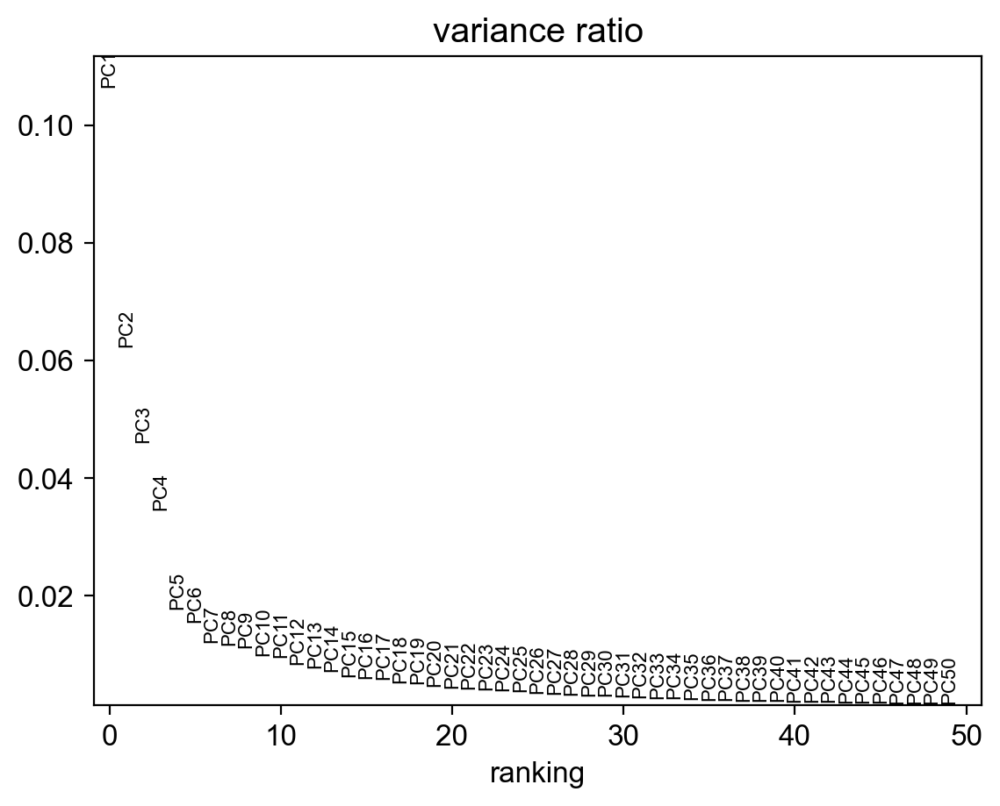

In [ ]:
sc.pl.pca_variance_ratio(ad_forAlignmentScore, 50)

In [ ]:
ad_forAlignmentScore.obsm["X_pca20"] = ad_forAlignmentScore.obsm["X_pca"][:, :20]

In [ ]:
import jpy_tools.singleCellTools.others

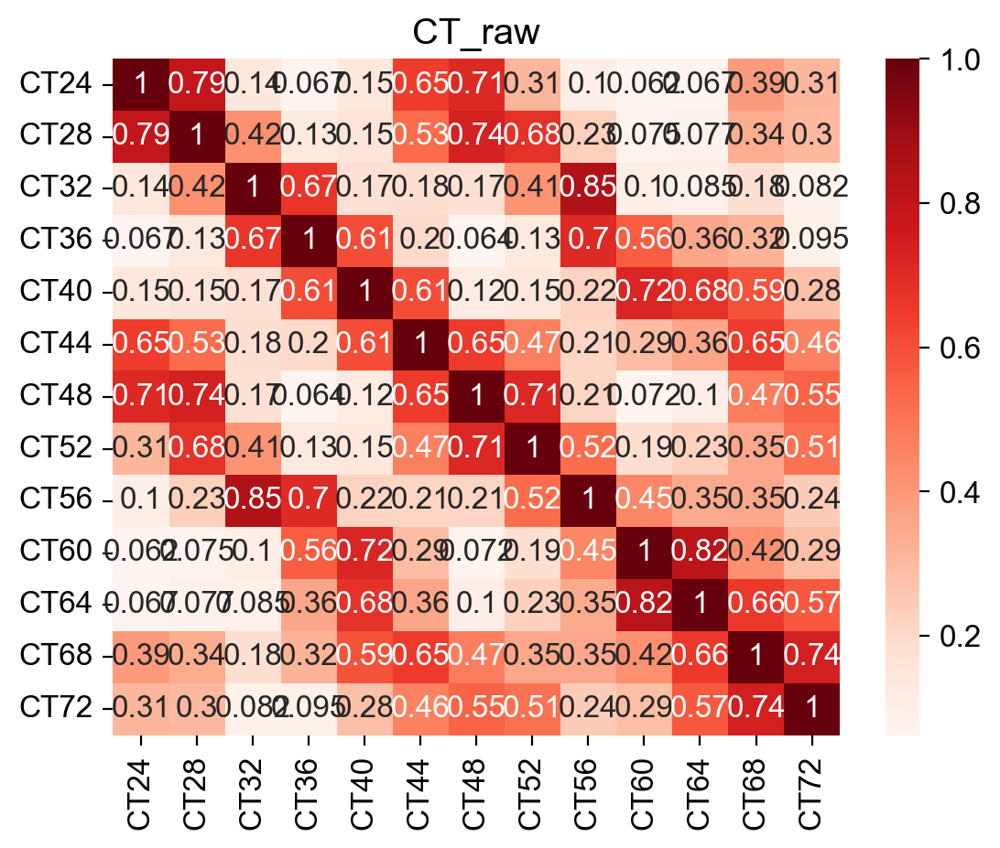

In [ ]:
df_alignScore, ax = jpy_tools.singleCellTools.others.getAlignmentScore(
    ad_forAlignmentScore, "CT_raw", "X_pca20"
)

In [ ]:
df_alignScore

,CT24,CT28,CT32,CT36,CT40,CT44,CT48,CT52,CT56,CT60,CT64,CT68,CT72
CT24,1.000000,0.787897,0.138450,0.066863,0.145683,0.647085,0.710083,0.311745,0.101993,0.062036,0.067159,0.389815,0.312177
CT28,0.787897,1.000000,0.419693,0.129870,0.152640,0.526902,0.738790,0.680553,0.233260,0.075286,0.076960,0.338843,0.301569
CT32,0.138450,0.419693,1.000000,0.671284,0.173718,0.179521,0.174852,0.413328,0.847061,0.104081,0.084833,0.179771,0.082050
CT36,0.066863,0.129870,0.671284,1.000000,0.605839,0.199071,0.064057,0.128898,0.704877,0.561048,0.356362,0.319390,0.094513
CT40,0.145683,0.152640,0.173718,0.605839,1.000000,0.605920,0.117675,0.145015,0.221288,0.717928,0.680591,0.590655,0.283019
CT44,0.647085,0.526902,0.179521,0.199071,0.605920,1.000000,0.648873,0.471866,0.214494,0.291106,0.358933,0.650672,0.460447
CT48,0.710083,0.738790,0.174852,0.064057,0.117675,0.648873,1.000000,0.711744,0.212337,0.072275,0.101382,0.474259,0.547805
CT52,0.311745,0.680553,0.413328,0.128898,0.145015,0.471866,0.711744,1.000000,0.522659,0.186509,0.228631,0.354041,0.508568
CT56,0.101993,0.233260,0.847061,0.704877,0.221288,0.214494,0.212337,0.522659,1.000000,0.446095,0.345437,0.353525,0.244244
CT60,0.062036,0.075286,0.104081,0.561048,0.717928,0.291106,0.072275,0.186509,0.446095,1.000000,0.820116,0.419795,0.288385


In [ ]:
df_alignScore.index = range(24, 76, 4) >> F(list)
df_alignScore.columns = range(24, 76, 4) >> F(list)
df_alignScore = df_alignScore.iloc[::-1]

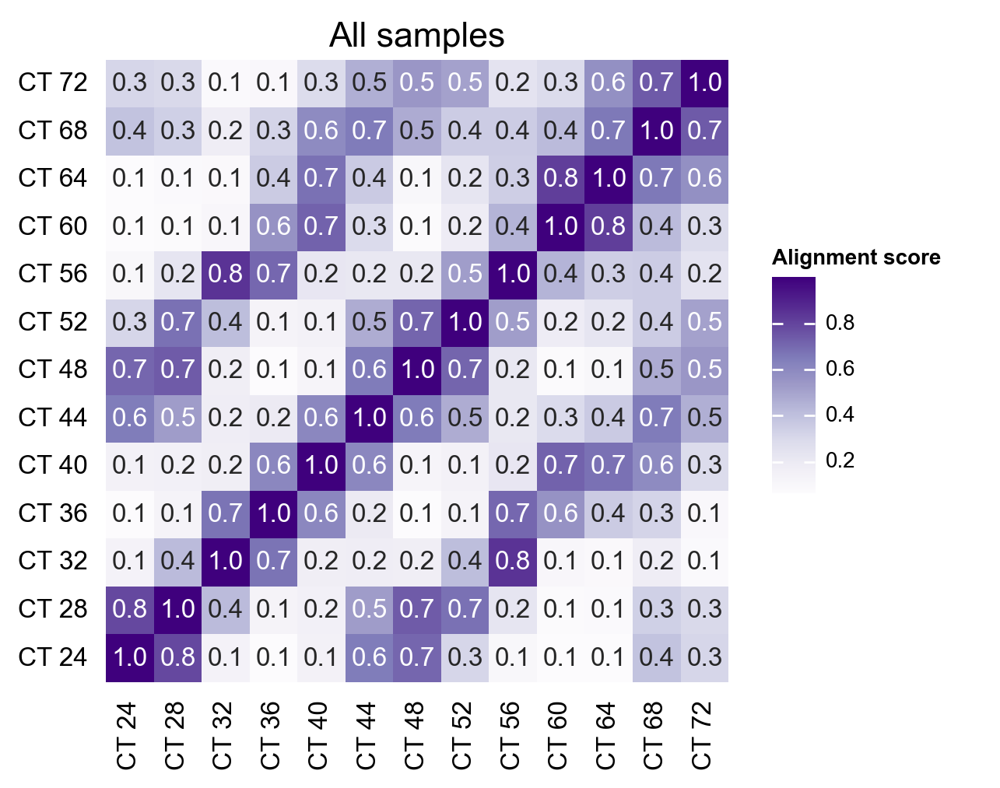

In [ ]:
fig = plt.figure(figsize=(10, 8))
g0 = ma.Heatmap(
    df_alignScore,
    cmap="Purples",
    annot=True,
    fmt=lambda x: f"{x:.1f}",
    label="Alignment score",
)
g0.add_top(ma.plotter.Title("All samples", fontsize=16))
g0.add_bottom(mp.Labels(df_alignScore.columns.map(lambda x: "CT " + str(x))), pad=0.1)
g0.add_left(mp.Labels(df_alignScore.index.map(lambda x: "CT " + str(x))), pad=0.1)
g0.add_legends(side="right")

# g0.add_left(
#     mp.Colors(
#         (df_alignScore.index % 4 == 0).tolist()
#         >> F(lambda _: np.where(_, "Batch 1", "Batch 2")),
#         palette=["#2077B4", "#92D050"],
#         label="Batch",
#         # label_loc="top",
#     ),
#     size=0.1,
# )

# g0.add_bottom(
#     mp.Colors(
#         (df_alignScore.columns % 4 == 0).tolist()
#         >> F(lambda _: np.where(_, "Batch 1", "Batch 2")),
#         palette=["#2077B4", "#92D050"],
#         label="Batch",
#         # label_loc="top",
#     ),
#     size=0.1, legend=False
# )

g0.render(fig)

# plot core driver genes

In [ ]:
import scipy

In [ ]:
ad_mergeAllCt = ead.pl.getPb(["CT_raw"]).copy()

In [ ]:
ad_mergeAllCt.obs["CT"] = ad_mergeAllCt.obs["CT_raw"].map(lambda _: _[2:])

In [ ]:
ad_mergeAllCt.obs.index = ad_mergeAllCt.obs["CT"].copy()

In [ ]:
ad_mergeAllCt.layers["normalize"] = np.exp2(ad_mergeAllCt.layers["normalize_log"]) - 1

In [ ]:
ls_plotGenes = [
    "AT2G46830",
    "AT1G01060",
    "AT2G46790",
    "AT5G02810",
    "AT3G09600",
    "AT5G52660",
    "AT5G02840",
    "AT5G64170",
    "AT3G54500",
    "AT5G24470",
    "AT5G60100",
    "AT5G61380",
    "AT1G22770",
    "AT5G59570",
    "AT3G46640",
    "AT2G40080",
    "AT2G25930",
    "AT5G57360",
    "AT3G02780",
]
ls_plotNames = [
    "CCA1",
    "LHY",
    "PRR9",
    "PRR7",
    "RVE8",
    "RVE6",
    "RVE4",
    "LNK1",
    "LNK2",
    "PRR5",
    "PRR3",
    "TOC1",
    "GI",
    "BOA",
    "LUX",
    "ELF4",
    "ELF3",
    "ZTL",
    "IPP2",
]
dt_plotGenes = dict(zip(ls_plotNames, ls_plotGenes))
dt_plotGenes

{'CCA1': 'AT2G46830',
 'LHY': 'AT1G01060',
 'PRR9': 'AT2G46790',
 'PRR7': 'AT5G02810',
 'RVE8': 'AT3G09600',
 'RVE6': 'AT5G52660',
 'RVE4': 'AT5G02840',
 'LNK1': 'AT5G64170',
 'LNK2': 'AT3G54500',
 'PRR5': 'AT5G24470',
 'PRR3': 'AT5G60100',
 'TOC1': 'AT5G61380',
 'GI': 'AT1G22770',
 'BOA': 'AT5G59570',
 'LUX': 'AT3G46640',
 'ELF4': 'AT2G40080',
 'ELF3': 'AT2G25930',
 'ZTL': 'AT5G57360',
 'IPP2': 'AT3G02780'}

In [ ]:
dt_coreGene = {
    x: dt_coreGene[x] for x in dt_plotGenes.values() if x in dt_coreGene.keys()
}
dt_coreGene

NameError: name 'dt_coreGene' is not defined

In [ ]:
ls_symOrder = "CCA1, LHY, RVE4, RVE8, RVE6, LNK1, LNK2, PRR9, PRR7, PRR5, PRR3, TOC1, GI, LUX, ELF4, ELF3, ZTL".split(
    ", "
)
dt_plotGenes = {k: dt_plotGenes[k] for k in ls_symOrder}

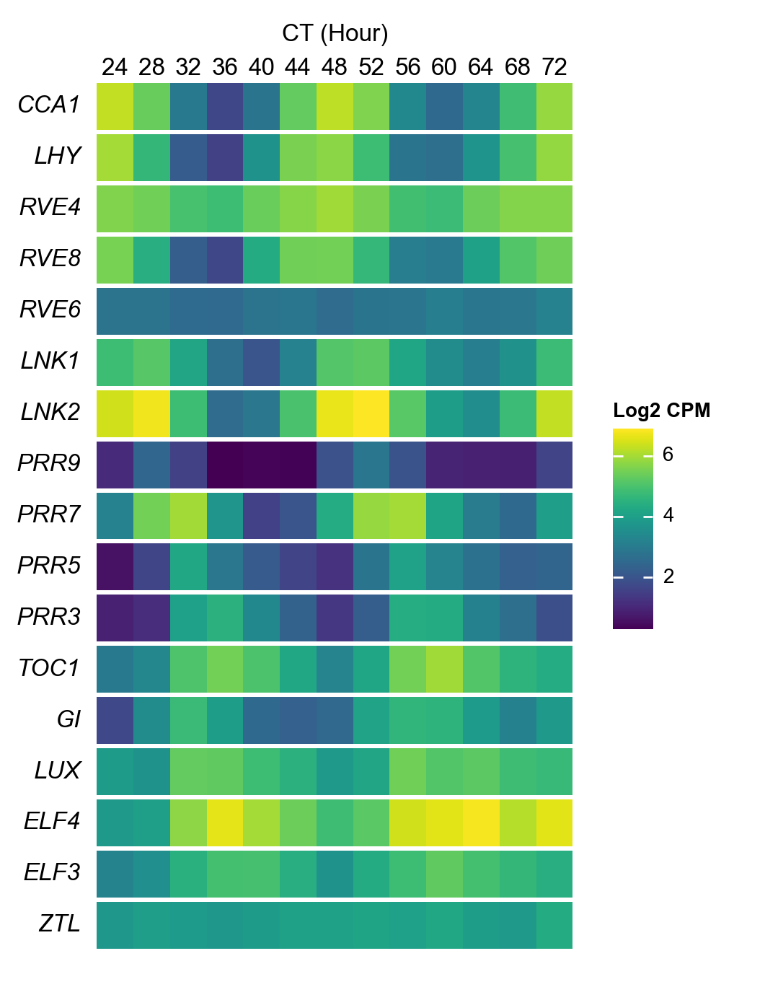

In [ ]:
h1 = heatmapMultiGeneInDifferentTime(
    ad_mergeAllCt,
    "normalize_log",
    dt_plotGenes.values() >> F(list),
    dt_plotGenes.keys() >> F(list),
    "Log2 CPM",
    cmap="viridis",
    scale=False,
)

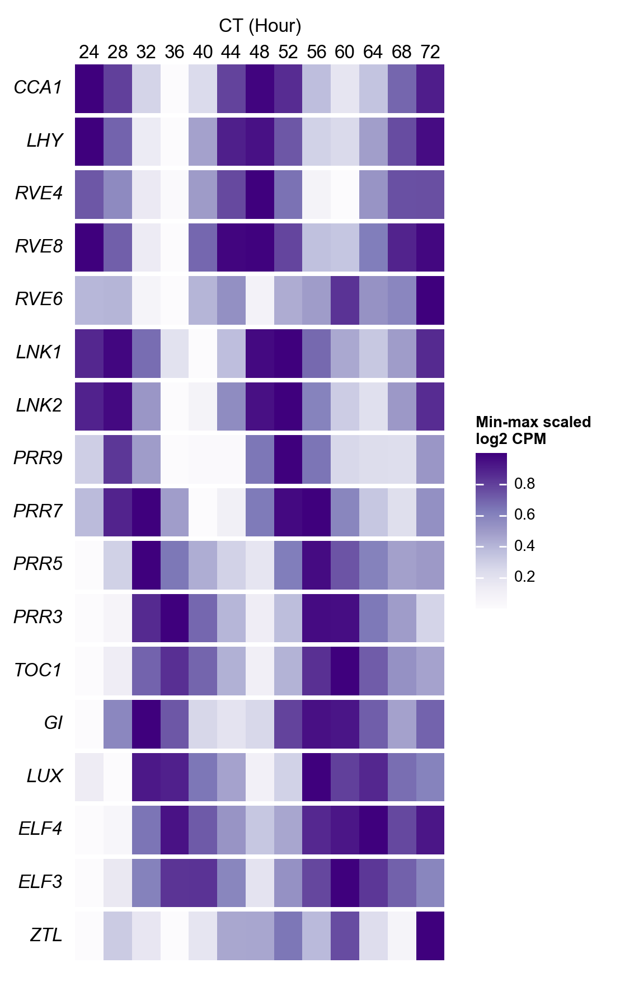

In [ ]:
h2 = heatmapMultiGeneInDifferentTime(
    ad_mergeAllCt,
    "normalize_log",
    dt_plotGenes.values() >> F(list),
    dt_plotGenes.keys() >> F(list),
    "Min-max scaled\nlog2 CPM",
    cmap="Purples",
    scale=True,
    height=8,
)

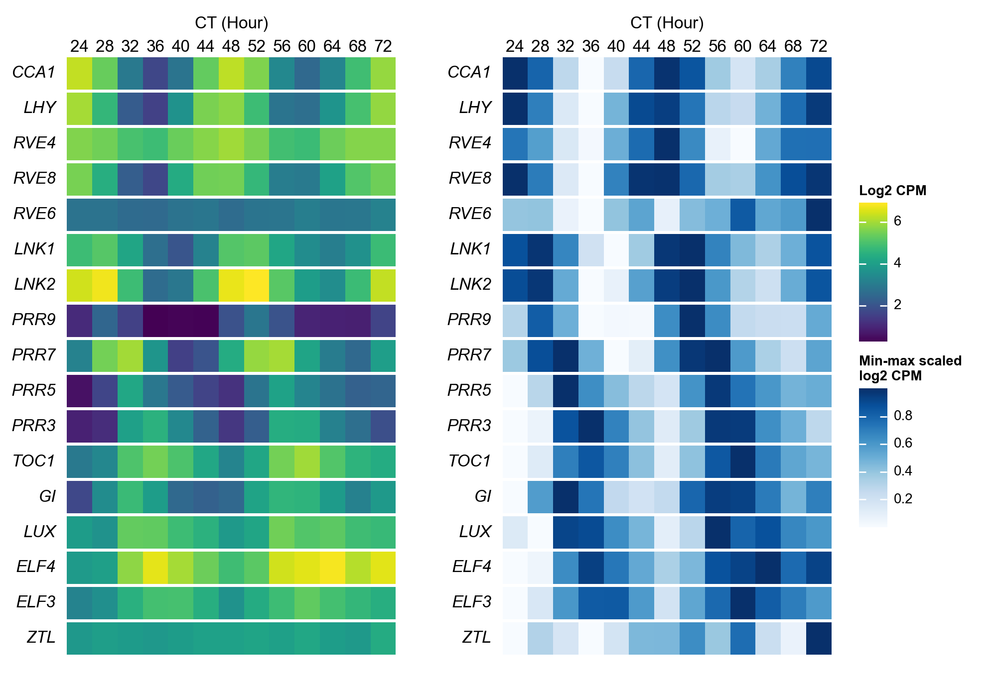

In [ ]:
h = h1 + 0.5 + h2
h.add_legends()
h.render()

In [ ]:
import legendkit
from matplotlib.legend_handler import HandlerLine2D

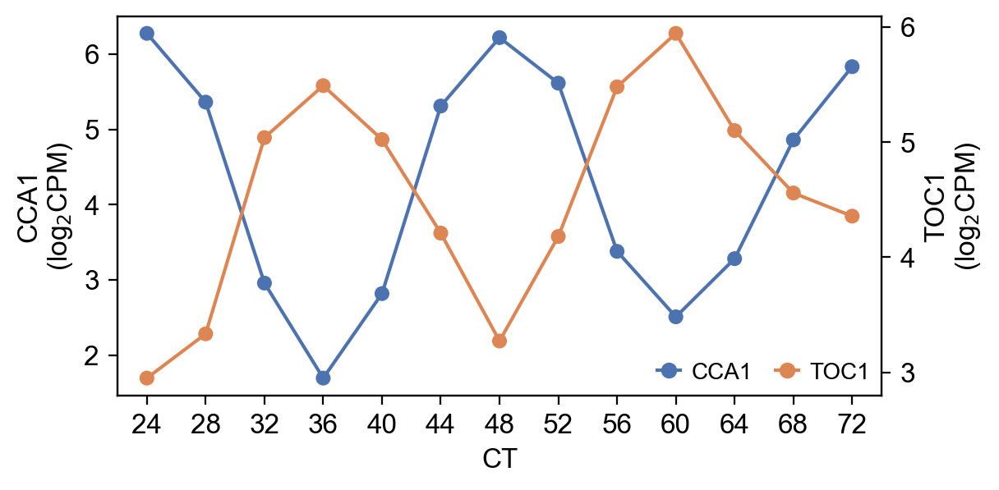

In [ ]:
_df = (
    ad_mergeAllCt[:, ["AT2G46830", "AT5G61380"]]
    .to_df("normalize_log")
    .join(ad_mergeAllCt.obs[["CT"]])
)

_df = _df.melt("CT", var_name="gene", value_name="CPM")
_df["name"] = _df["gene"].map(dt_coreGene)
fig, ax1 = plt.subplots(figsize=(6, 3))
ax2 = ax1.twinx()

(
    so.Plot(_df.query("gene=='AT2G46830'"), x="CT", y="CPM")
    .add(so.Dot(color="#4C72B0"))
    .add(so.Line(color="#4C72B0"))
    .theme(dt_snsStyle)
    .label(color="", y="CCA1\n(log$_{2}$CPM)")
    .on(ax1)
    .plot()
)

(
    so.Plot(_df.query("gene=='AT5G61380'"), x="CT", y="CPM")
    .add(so.Dot(color="#DD8553"))
    .add(so.Line(color="#DD8553"))
    .theme(dt_snsStyle)
    .label(color="", y="TOC1\n(log$_{2}$CPM)")
    .on(ax2)
    .plot()
)

legendkit.legend(
    ax2,
    loc="lower right",
    ncol=2,
    legend_items=[
        ("line", "CCA1", {"color": "#4C72B0", "marker": "o"}),
        ("line", "TOC1", {"color": "#DD8553", "marker": "o"}),
    ],
)
ax2.yaxis.tick_right()
# ax2.set_ylabel(ax2.get_ylabel(), rotation=270, labelpad=30)
# ax1.set_ylabel(ax1.get_ylabel(), rotation=270, labelpad=30)
plt.show()

# Annotation (Coarse)

## Compare with pseudo-seedling

2024-08-07 16:37:28.576 | DEBUG    | jpy_tools.singleCellTools.plotting:_embedding:1591 - ls_color: Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24',
       '25', '26', '27', '28', '29', '30', '31'],
      dtype='object')


2024-08-07 16:37:30.145 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888


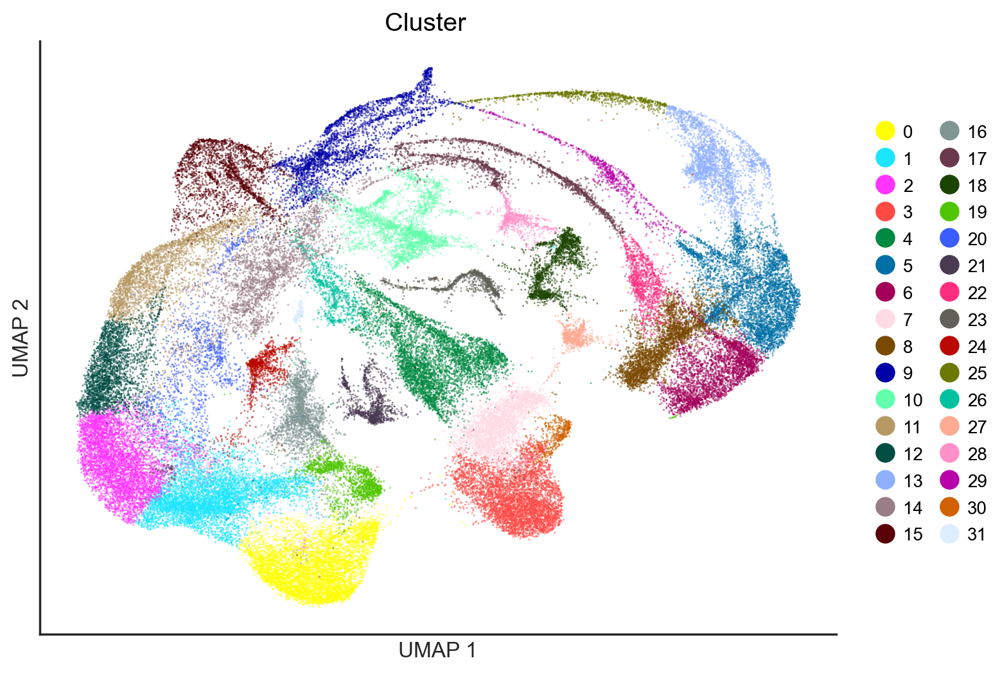

In [ ]:
ead.pl.embedding(color="Cluster", size=0.2, legendCol=2)

2024-08-08 16:03:47.445 | DEBUG    | jpy_tools.singleCellTools.plotting:_embedding:1591 - ls_color: Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24',
       '25', '26', '27', '28', '29', '30', '31'],
      dtype='object')
2024-08-08 16:03:49.218 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888


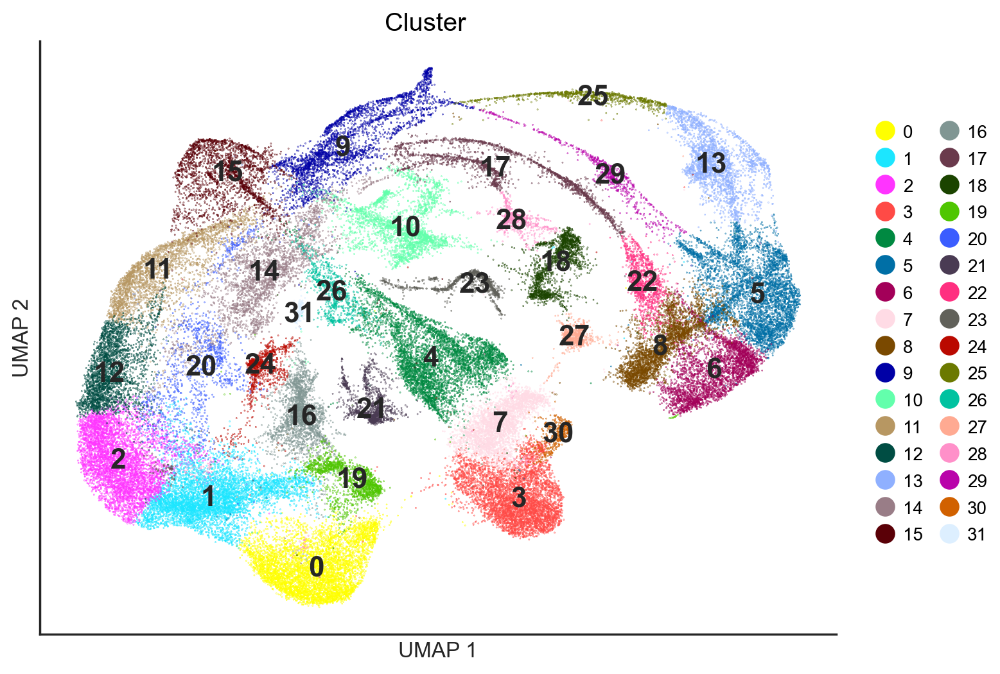

In [ ]:
ead.pl.embedding(color="Cluster", size=0.2, legendCol=2, legendInFig=True, legendFigArtistKws=dict(weight="bold", fontsize=16))

In [ ]:
ead.cl.getClusterSpecGeneByCellex("Cluster")

Global seed set to 0


cutoff   0.60  0.70  0.80  0.90  0.95  0.99
Cluster                                    
5        1893  1304   787   297    96     0
3        1889  1348   832   383   153    12
0        1853  1346   804   321   122     6
9        1788  1244   758   272    95     0
6        1783  1253   761   310   123     6
11       1634  1146   683   252    79     4
15       1384   957   594   289   146     0
13       1343   993   642   293    81     0
10       1317   966   651   331   123     0
12       1280   927   561   202    53     1
14       1238   809   435   158    75     6
2        1214   868   522   170    33     0
17       1083   736   488   201    77     4
25       1033   748   483   184    65     1
4        1008   728   457   207    83     9
29        939   669   420   149    56     1
1         904   634   352    86     6     0
19        893   604   376   171    82    14
22        870   600   375   162    69     1
18        849   635   428   201    82     0
30        848   512   318   141 

In [ ]:
dt_specGenes = ead.uns["Cluster_cellexES"].query("enrichScore > 0.95").sort_values(
    "enrichScore", ascending=False
).groupby("Cluster").apply(lambda x: x["gene"].tolist()).to_dict()
dt_specGenes = {x: y for x, y in dt_specGenes.items() if len(y) > 0}

In [ ]:
# ead.initLayer()

In [ ]:
import sys
sys.setrecursionlimit(10000)

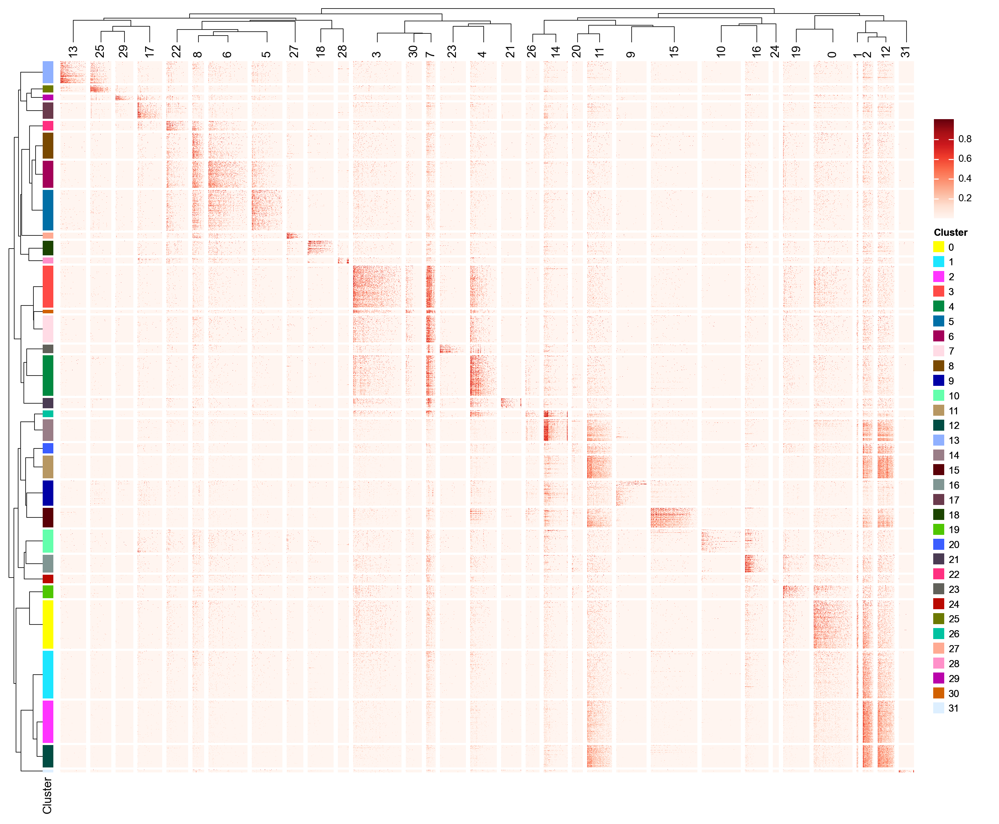

In [ ]:
h = ead.pl.heatmapGeneExp(None, ['Cluster'], dt_specGenes, width=12, standardScale=0, cellSplitBy='Cluster')
h.add_dendrogram('top', meta_linkage=ead.uns['dendrogram_Cluster']['linkage'], add_base=False)
h.add_dendrogram('left', meta_linkage=ead.uns['dendrogram_Cluster']['linkage'], add_base=False)
h.render()

In [ ]:
ad_pub = sc.read_h5ad(f"/datapool/data/Users/zhijian/ipf/circadian_data/ad_pub_after_calc_sn_auc.h5ad")

In [ ]:
# ad_pub.write_h5ad(f"/datapool/data/Users/zhijian/ipf/circadian_data/ad_pub_after_calc_sn_auc.h5ad")

In [ ]:
dt_pubSpecGenes = (
    ad_pub.uns["pub_cellex_cellexES"]
    .query("enrichScore > 0.9")
    .sort_values(["celltype", "enrichScore"], ascending=[True, False])
    .groupby("celltype")["gene"]
    .agg(list)
    .to_dict()
)

In [ ]:
df_specGeneJarccard = pd.DataFrame(
    index=dt_pubSpecGenes.keys(), columns=dt_specGenes.keys()
)
for k1, v1 in dt_pubSpecGenes.items():
    for k2, v2 in dt_specGenes.items():
        df_specGeneJarccard.loc[k1, k2] = len(set(v1) & set(v2)) / len(
            set(v1) | set(v2)
        )
df_specGeneJarccard = df_specGeneJarccard.astype(float)

In [ ]:
ls_geneCat = np.where(df_specGeneJarccard.index.str.contains(":"), "Shoot", "Root")

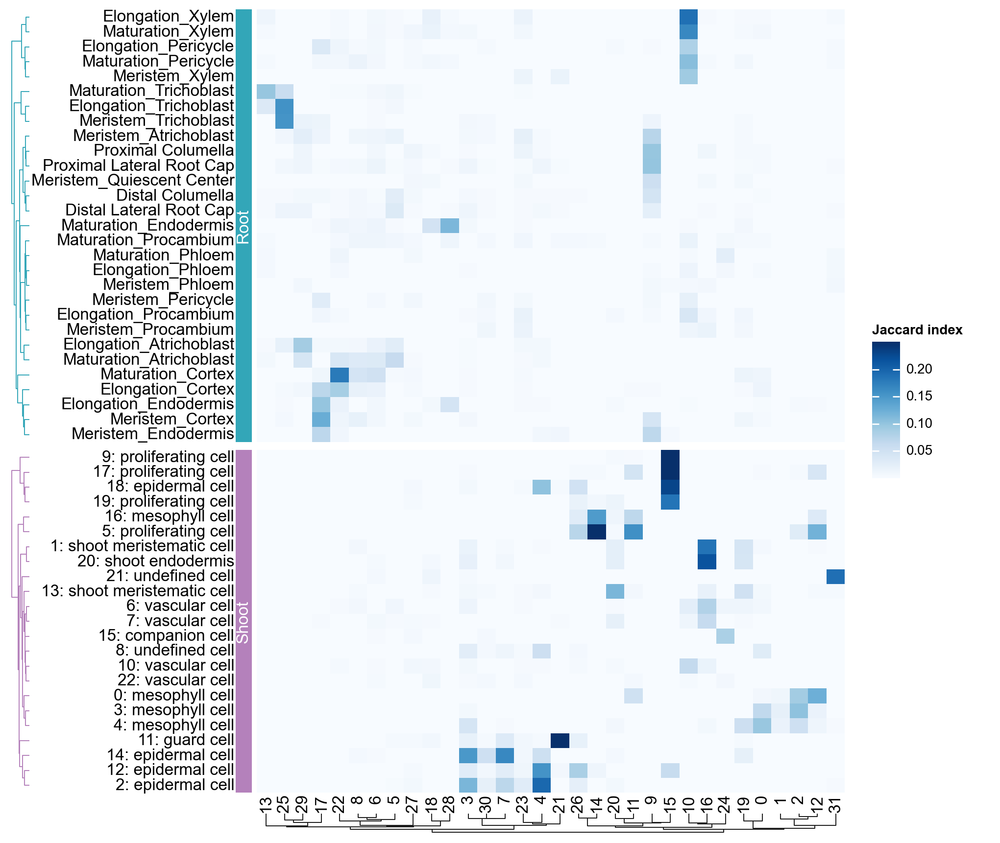

In [ ]:
g = ma.Heatmap(
    df_specGeneJarccard.values,
    cmap="Blues",
    width=6,
    height=8,
    vmax=0.25,
    label="Jaccard index",
)

g.hsplit(labels=ls_geneCat, order=["Root", "Shoot"])

g.add_left(
    ma.plotter.Chunk(
        ["Root", "Shoot"],
        fill_colors=["#33A6B8", "#B481BB"],
        color="white",
        padding=1.2,
    ),
    pad=0.05,
)
g.add_left(mp.Labels(df_specGeneJarccard.index))

g.add_dendrogram(
    "left",
    colors=["#33A6B8", "#B481BB"],
    method="ward",
    metric="euclidean",
    add_meta=False,
    size=0.2,
)
g.add_bottom(mp.Labels(df_specGeneJarccard.columns))
g.add_dendrogram("bottom", linkage=ead.uns['dendrogram_Cluster']['linkage'], size=0.2)
g.add_legends(pad=-0.5)

g.render()

### pseudo-seedling spec gene AUC in circadian data

In [ ]:
ad_pub

AnnData object with n_obs × n_vars = 73286 × 23505
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'seurat_clusters', 'old.ident', 'celltype', 'tissue'
    uns: 'pub_cellex_cellexES'
    obsm: 'X_umap', 'snCircadian_AUC'
    varm: 'pub_cellex_cellexES'
    layers: 'RNA_counts', 'RNA_data', 'normalize_log', 'raw'

In [ ]:
ad_pub.obs

,orig.ident,nCount_RNA,nFeature_RNA,seurat_clusters,old.ident,celltype,tissue
TATCTGTGTATCGTTG_13,col0,5262.0,1884,22,96,Maturation_Trichoblast,Root
GATTTCTAGCCTGCCA_11,tnw1,21006.0,3540,25,14,Elongation_Cortex,Root
GAGACTTCAACCAATC_12,tnw2,24610.0,4951,9,112,Elongation_Phloem,Root
GGGTGTCAGCTGCCTG_13,col0,2410.0,1237,14,47,Elongation_Phloem,Root
CTTCTCTTCTCAGTCC_10,sc_1,65389.0,7783,7,35,Elongation_Trichoblast,Root
...,...,...,...,...,...,...,...
leaf3_TTTGTCATCCAAACAC,10X_leaf3,5985.0,2210,11,10X_leaf3,11: guard cell,Shoot
leaf3_TTTGTCATCCCTCAGT,10X_leaf3,25294.0,3537,4,10X_leaf3,4: mesophyll cell,Shoot
leaf3_TTTGTCATCCGTAGGC,10X_leaf3,9970.0,2485,0,10X_leaf3,0: mesophyll cell,Shoot
leaf3_TTTGTCATCGGAATCT,10X_leaf3,19316.0,3389,4,10X_leaf3,4: mesophyll cell,Shoot


In [ ]:
ead.addRef(ad_pub, "celltype", resultKey='pseudoSeedling')

In [ ]:
ead.anno.getAUCellScore(dt_pubSpecGenes, threads=20)

Create regulons from a dataframe of enriched features.
Additional columns saved: []


100%|██████████| 8/8 [03:07<00:00, 23.47s/it]


In [ ]:
import scipy

In [ ]:
_lkg = scipy.cluster.hierarchy.linkage(ead.obsm['AUCell'].groupby(ead.obs['Cluster']).mean().T, method='complete', metric='cosine', optimal_ordering=True)

2024-08-08 17:30:43.993 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888
2024-08-08 17:30:46.043 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888
2024-08-08 17:30:47.925 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888
2024-08-08 17:30:49.802 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888
2024-08-08 17:30:51.680 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888
2024-08-08 17:30:53.556 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888
2024-08-08 17:30:55.426 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888
2024-08-08 17:30:57.303 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888


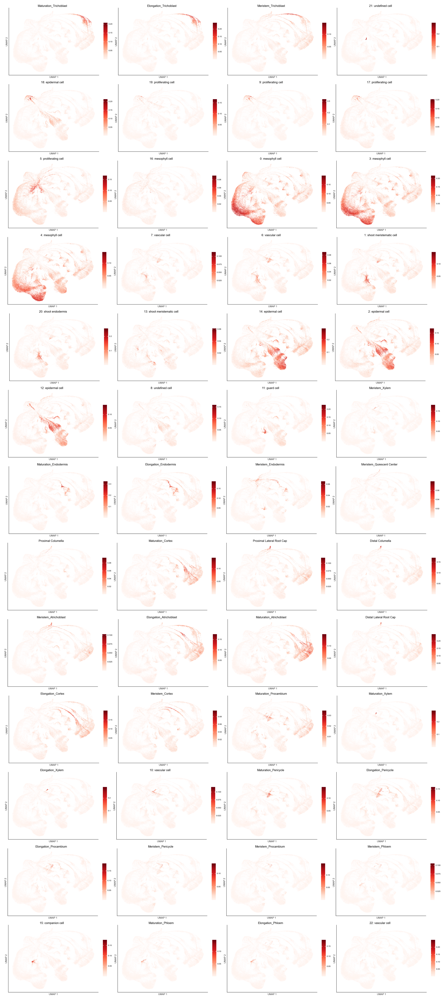

In [ ]:
ead.pl.embedding(color=ead.obsm['AUCell'].iloc[:, scipy.cluster.hierarchy.leaves_list(_lkg)].columns, colorUseObsm='AUCell', size=0.2, ).show([40, 40])

### circadian spec gene AUC in pseudoSeedling data

In [ ]:
ead_pseSdl = singleCellTools.EnhancedAnndata(ad_pub, 'raw')

2024-08-08 09:14:11.196 | WARNING  | jpy_tools.singleCellTools:__init__:410 - The index of ad.obs contains '_' which may cause some problems, please remove it first
2024-08-08 09:14:11.203 | WARNING  | jpy_tools.singleCellTools:rawLayer:463 - rawLayer will be overwritten by raw and all the related objects will be re-initialized
2024-08-08 09:14:11.203 | WARNING  | jpy_tools.singleCellTools:rawLayer:463 - rawLayer will be overwritten by raw and all the related objects will be re-initialized


In [ ]:
ead_pseSdl.addRef(ead.ad, 'Cluster', resultKey='circadianSpec')

In [ ]:
dt_specGenesForAuc = {x:[z for z in y if z in ead_pseSdl.var.index] for x, y in dt_specGenes.items()}

In [ ]:
dt_specGenesForAuc = {x: y for x, y in dt_specGenesForAuc.items() if len(y) > 0}

In [ ]:
ead_pseSdl.anno.getAUCellScore(dt_specGenesForAuc, threads=20, label='circadianSpec')

Create regulons from a dataframe of enriched features.
Additional columns saved: []


100%|██████████| 8/8 [02:33<00:00, 19.24s/it]


In [ ]:
def reloadPackages(package):
    import importlib
    from types import ModuleType
    for p in dir(package):
        p = getattr(package, p)
        if isinstance(p, ModuleType):
            importlib.reload(p)
    importlib.reload(package)

reloadPackages(singleCellTools)
ead_pseSdl = singleCellTools.EnhancedAnndata(ead_pseSdl.ad)

2024-08-08 11:21:50.099 | WARNING  | jpy_tools.singleCellTools:__init__:410 - The index of ad.obs contains '_' which may cause some problems, please remove it first
2024-08-08 11:21:50.106 | WARNING  | jpy_tools.singleCellTools:rawLayer:463 - rawLayer will be overwritten by raw and all the related objects will be re-initialized
2024-08-08 11:21:50.106 | WARNING  | jpy_tools.singleCellTools:rawLayer:463 - rawLayer will be overwritten by raw and all the related objects will be re-initialized


2024-08-08 16:55:50.638 | DEBUG    | jpy_tools.singleCellTools.plotting:_embedding:1591 - ls_color: Index(['0: mesophyll cell', '1: shoot meristematic cell', '2: epidermal cell',
       '3: mesophyll cell', '4: mesophyll cell', '5: proliferating cell',
       '6: vascular cell', '7: vascular cell', '8: undefined cell',
       '9: proliferating cell', '10: vascular cell', '11: guard cell',
       '12: epidermal cell', '13: shoot meristematic cell',
       '14: epidermal cell', '15: companion cell', '16: mesophyll cell',
       '17: proliferating cell', '18: epidermal cell',
       '19: proliferating cell', '20: shoot endodermis', '21: undefined cell',
       '22: vascular cell', 'Distal Columella', 'Distal Lateral Root Cap',
       'Elongation_Atrichoblast', 'Elongation_Cortex', 'Elongation_Endodermis',
       'Elongation_Pericycle', 'Elongation_Phloem', 'Elongation_Procambium',
       'Elongation_Trichoblast', 'Elongation_Xylem', 'Maturation_Atrichoblast',
       'Maturation_Cortex', '

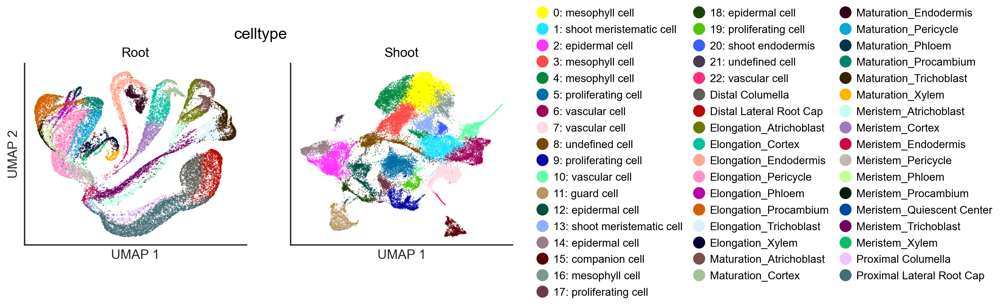

In [ ]:
ead_pseSdl.pl.embedding(color='celltype', groupby='tissue', colorUseObsm='circadianSpec', size=0.2, figsize=(8, 3), legendCol=3, fc_additional=lambda _: _.share(x=False, y=False))

In [ ]:
ead_pseSdl.pl.embedding(color=ead.uns['dendrogram_Cluster']['categories_ordered'], groupby='tissue', colorUseObsm='circadianSpec', size=0.2, wrap=4, figsize=(8, 3)).show([40, 40])

## Further Subclustering

### C 9 / 17 / 16 / 23

2024-08-08 17:16:00.569 | DEBUG    | jpy_tools.singleCellTools.plotting:_embedding:1591 - ls_color: Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24',
       '25', '26', '27', '28', '29', '30', '31'],
      dtype='object')
2024-08-08 17:16:02.361 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888


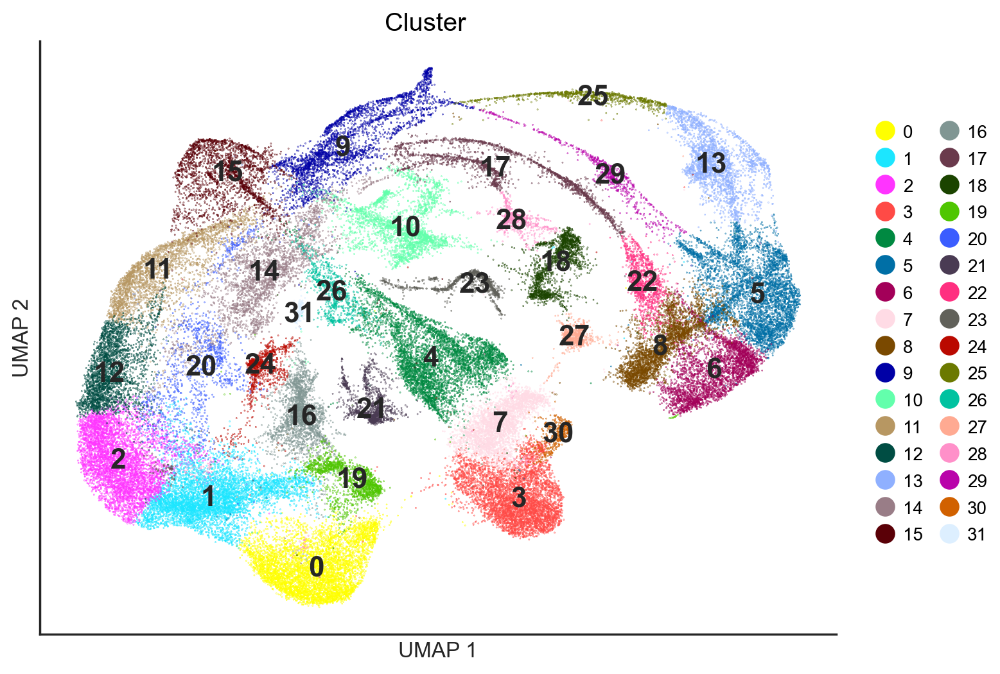

In [ ]:
ead.pl.embedding(color="Cluster", size=0.2, legendCol=2, legendInFig=True, legendFigArtistKws=dict(weight="bold", fontsize=16))

2024-08-28 16:54:16.210 | DEBUG    | jpy_tools.singleCellTools.plotting:_embedding:1591 - ls_color: Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9-0', '9-1', '9-2', '9-3',
       '10-0', '10-1', '10-2', '11', '12', '13', '14', '15', '16-0', '16-1',
       '17-0', '17-1', '17-2', '18', '19', '20', '21', '22', '23', '24', '25',
       '26', '27', '28', '29', '30', '31'],
      dtype='object')
2024-08-28 16:54:17.625 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888


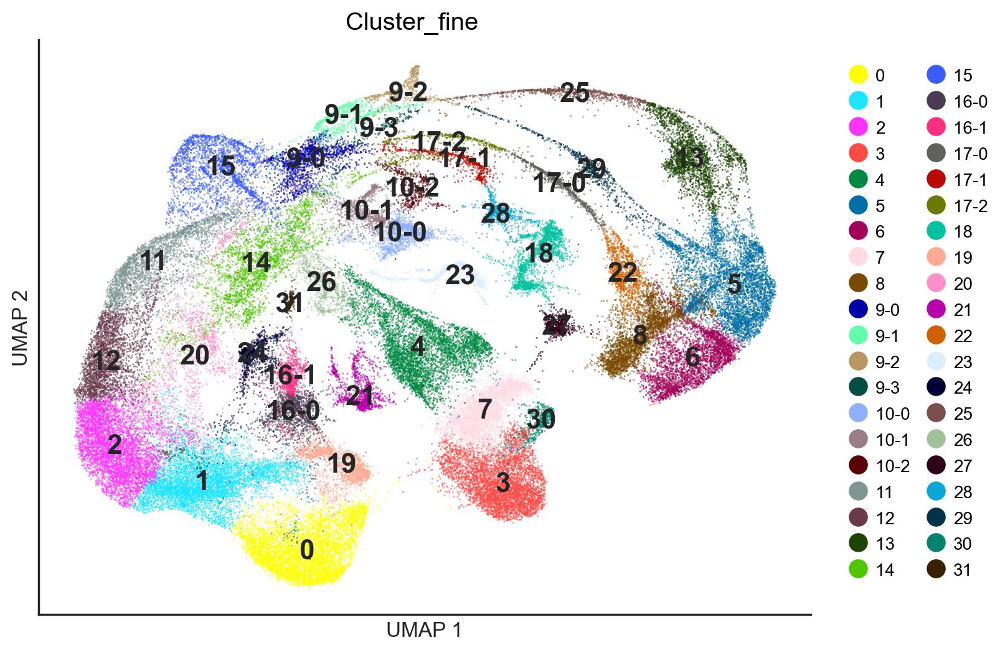

In [ ]:
sc.tl.leiden(ead.ad, resolution=0.2, restrict_to=('Cluster', ['9']), key_added='temp')
sc.tl.leiden(ead.ad, resolution=0.1, restrict_to=('temp', ['17']), key_added='temp')
sc.tl.leiden(ead.ad, resolution=0.2, restrict_to=('temp', ['16']), key_added='temp')
sc.tl.leiden(ead.ad, resolution=0.1, restrict_to=('temp', ['10']), key_added='Cluster_fine')

ead.obs['Cluster_fine'] = ead.obs['Cluster_fine'].str.replace(',', '-')
ead.pl.embedding(color="Cluster_fine", size=0.2, legendCol=2, legendInFig=True, legendFigArtistKws=dict(weight="bold", fontsize=16))

In [ ]:
sc.tl.dendrogram(ead.ad, 'Cluster_fine', use_rep='X_pca_harmony', optimal_ordering=True)

2024-08-28 16:58:30.590 | DEBUG    | jpy_tools.singleCellTools.plotting:_embedding:1591 - ls_color: Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9-0', '9-1', '9-2', '9-3',
       '10-0', '10-1', '10-2', '11', '12', '13', '14', '15', '16-0', '16-1',
       '17-0', '17-1', '17-2', '18', '19', '20', '21', '22', '23', '24', '25',
       '26', '27', '28', '29', '30', '31'],
      dtype='object')
2024-08-28 16:58:32.207 | INFO     | jpy_tools.singleCellTools.plotting:_embedding:1718 - Title location: 0.8938888888888888


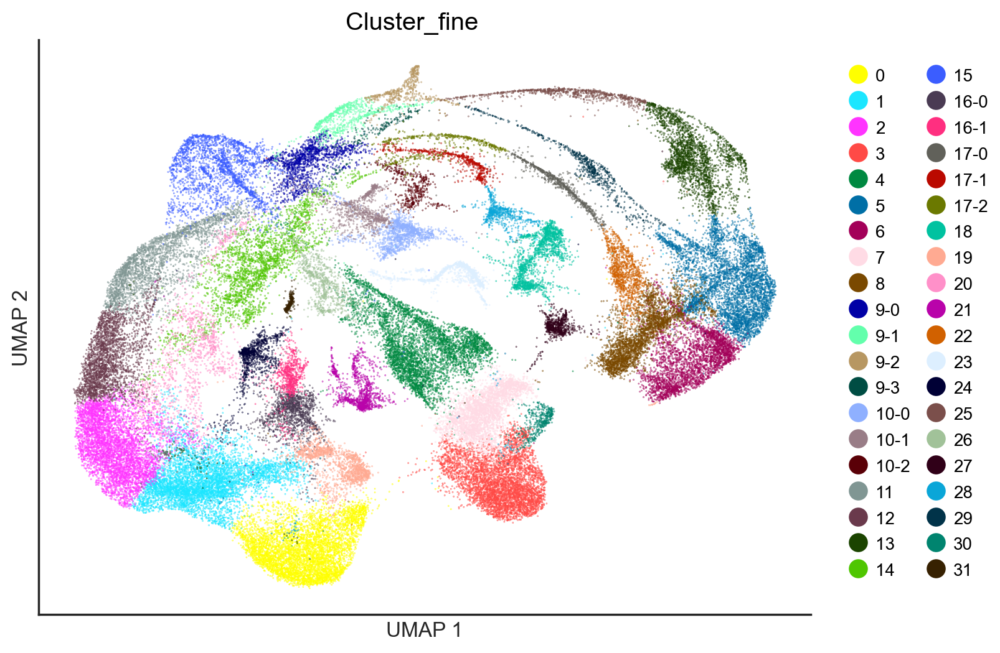

In [ ]:
ead.pl.embedding(color="Cluster_fine", size=0.2, legendCol=2, legendInFig=False, legendFigArtistKws=dict(weight="bold", fontsize=16))

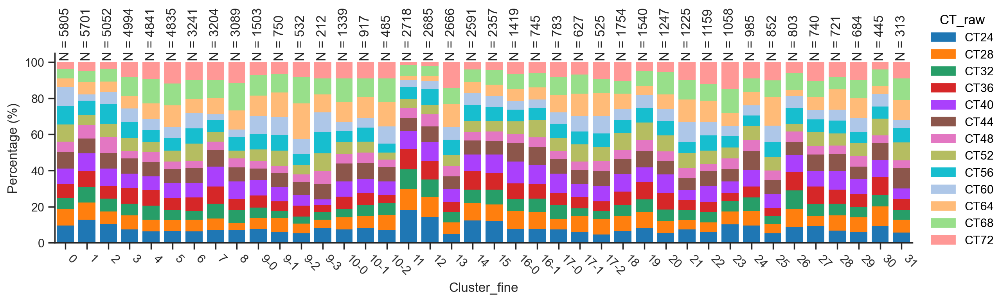

In [ ]:
fig = ead.pl.clusterPercentage(x='Cluster_fine', y='CT_raw', figsize=(12, 4))[1]
for ax in fig.axes:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=-45, ha='left')
fig